In [1]:
%runfile H3.py

In [2]:
from utils import (make_M_alphas, 
                   make_poly_from_edges, 
                   poly_equiv, tri0, tri1, tri2, cycle_poly, std_poly,
                   poly_gl2_orbit_reps, 
                   aas_triangle_gl2_orbit_reps, 
                   square_parameters, 
                   aaa_triangle_parameters, 
                   aas_triangle_parameters,
                   hexagon_parameters)

In [3]:
kdata = make_k(-31)
k = kdata['k']
w = kdata['w']
zero = k(0)
one = k(1)
Ireps = kdata['Ireps']
inf = cusp(infinity, k)

In [4]:
alphas = precomputed_alphas(k)
M_alphas, alpha_inv = make_M_alphas(alphas)

#assert alphas == [cusp(zero), cusp((w+1)/2), cusp(5/(2*w)), cusp(-5/(2*w))]

sigmas = singular_points_new(k)
assert sigmas == [inf, cusp((w-1)/2), cusp(w/2)]


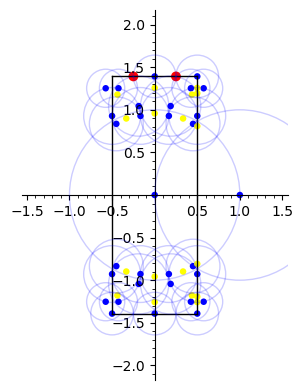

In [5]:
plot_FunDomain_projection(k, alphas, sigmas)

In [6]:
polys, hemis = all_polyhedra(k)
print("{} polyhedra constructed".format(len(polys)))

New orbit from P_0=[3/7*w + 2/7, 2/49]: {0, 1}
New orbit from P_2=[-14/31*w + 7/31, 11/248]: {2, 5, 6, 7}
New orbit from P_3=[14/31*w + 17/62, 11/248]: {8, 9, 3, 4}
New orbit from P_10=[32/93*w - 16/93, 23/279]: {10, 13, 14}
New orbit from P_11=[10/31*w + 16/93, 23/279]: {11, 12, 15}
New orbit from P_16=[9/31*w + 11/31, 3/31]: {16}
New orbit from P_17=[-9/31*w + 20/31, 3/31]: {17}
Found [[17], [0, 1], [8, 9, 3, 4], [11, 12, 15], [10, 13, 14], [2, 5, 6, 7], [16]] orbits:
Constructed 7 polyhedra
Faces: [[4, 4, 3, 4, 3], [3, 3, 3, 3], [3, 3, 3, 3], [4, 3, 4, 3, 4], [4, 3, 4, 3, 4], [3, 3, 3, 3], [4, 4, 3, 4, 3]]
New orbit from R_0=[43/80*w - 57/80, 31/640]: {0, 3, 5}
New orbit from R_1=[37/80*w - 27/40, 31/640]: {1, 2, 4}
Found 2 orbits with representative points [[1, 2, 4], [0, 3, 5]]:
Constructed 2 polyhedra
Faces: [[3, 3, 3, 3], [3, 3, 3, 3]]
New orbit from R_0=[43/80*w + 7/40, 31/640]: {0, 3, 4}
New orbit from R_1=[37/80*w + 17/80, 31/640]: {1, 2, 5}
Found 2 orbits with representative

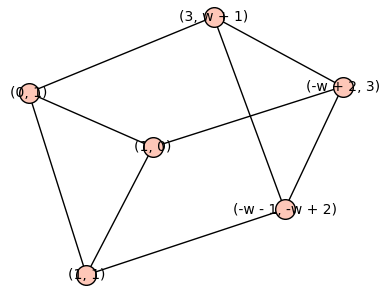

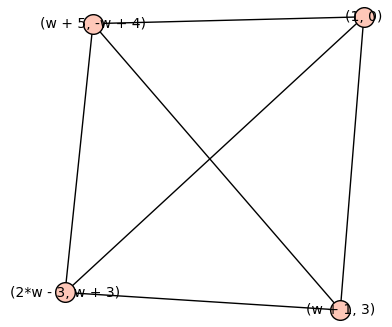

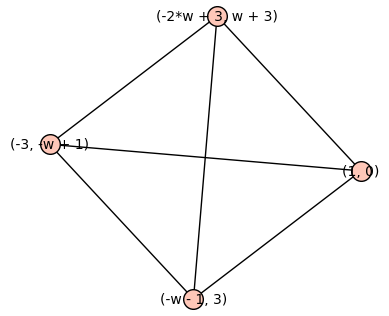

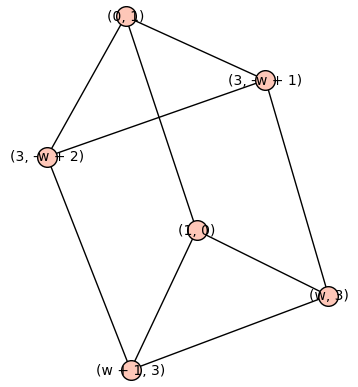

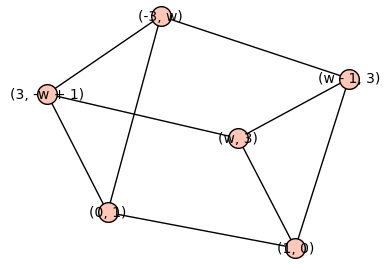

...

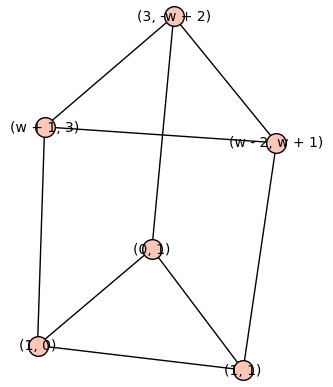

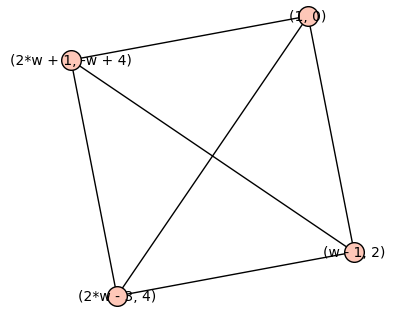

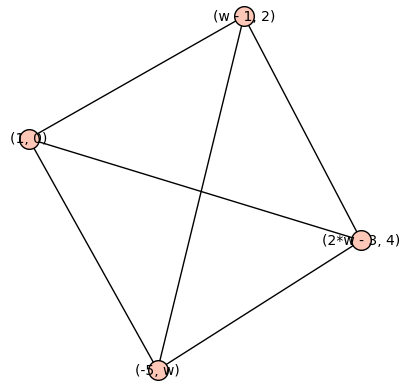

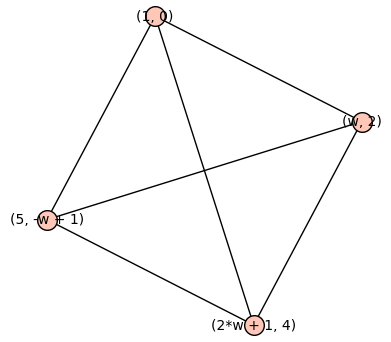

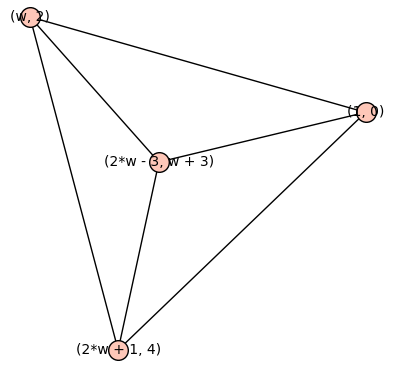

In [7]:
assert len(polys)==11
for G in polys: show(G)

In [8]:
triangles = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==3] for G in polys],[])]
squares = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==4] for G in polys],[])]
hexagons = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==6] for G in polys],[])]
aaa_triangles = [T for T in triangles if is_poly_principal(T)]
aas_triangles = [T for T in triangles if not is_poly_principal(T)]

In [9]:
[len(t) for t in [aaa_triangles, aas_triangles, squares, hexagons]]

[24, 12, 12, 0]

In [10]:
aaa_triangles0 = poly_gl2_orbit_reps(aaa_triangles, alphas)
aas_triangles0 = aas_triangle_gl2_orbit_reps(aas_triangles, alphas)
squares0 = poly_gl2_orbit_reps(squares, alphas)
hexagons0 = poly_gl2_orbit_reps(hexagons, alphas)

In [11]:
[len(t) for t in [aaa_triangles0, aas_triangles0, squares0, hexagons0]]

[6, 6, 2, 0]

In [12]:
[square_parameters(S, alphas, M_alphas, alpha_inv) for S in squares0]

[[[8, 0, 8, 0], [1, -1, 0]], [[0, 5, 0, 6], [0, 0, 0]]]

In [13]:
[aas_triangle_parameters(T, alphas, M_alphas, sigmas) for T in aas_triangles0]

[[[9, 1, 1], -w + 1],
 [[2, 1, 1], -w],
 [[19, 1, 1], 1],
 [[12, 2, 2], -w],
 [[2, 2, 2], -w],
 [[17, 2, 2], -1]]

In [14]:
triangles1 = [T for T in aaa_triangles0 if not any(poly_equiv(T, t) for t in [tri0(k), tri1(k), tri2(k)])]
triangles1

[[[-w + 6:-w - 3], oo, [2*w + 1:-w + 4]],
 [[3:w], oo, [w - 2:-3]],
 [[-3:-w + 1], oo, [2*w - 3:-w - 3]],
 [[2*w + 1:4], oo, [-w - 5:w - 4]],
 [[-w:3], oo, [-w + 1:3]]]

In [15]:
[aaa_triangle_parameters(T, alphas, M_alphas) for T in triangles1]

[[20, 8, 17], [8, 12, 9], None, [1, 19, 10], [4, 5, 7]]

In [16]:
[hexagon_parameters(H, alphas, M_alphas) for H in hexagons0]

[]

In [17]:
plot_Bianchi_diagram(k,hemis)

Graphics3d Object

In [18]:
from polyhedra import all_poly_types, poly_types

In [19]:
poly_types(polys)

{'tetrahedron': 7,
 'cube': 0,
 'triangular prism': 4,
 'square prism': 0,
 'hexagonal prism': 0,
 'hexagonal cap': 0,
 'truncated tetrahedron': 0,
 'cuboctahedron': 0}

In [20]:
all_poly_types(polys)

['triangular prism',
 'tetrahedron',
 'tetrahedron',
 'triangular prism',
 'triangular prism',
 'tetrahedron',
 'triangular prism',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron']